<a href="https://colab.research.google.com/github/hmustafa9/Seoul_Bike_Rental_Analysis/blob/main/ML2_REG.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!gdown 1laSw-_VNip0pjXxn-M6mmIkBjgJMfH7U

Downloading...
From: https://drive.google.com/uc?id=1laSw-_VNip0pjXxn-M6mmIkBjgJMfH7U
To: /content/Copy of r4.csv
100% 2.91M/2.91M [00:00<00:00, 150MB/s]


In [ ]:
import pandas as pd
import numpy as np
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
file1=pd.read_csv('/content/Copy of r4.csv')

In [ ]:
#checking for null Values
data=file1.copy()
data.isnull().sum().sort_values(ascending=False)/len(data)

id                       0.0
Functioning Day          0.0
Visibility               0.0
Temperature              0.0
Solar Radiation          0.0
Snowfall                 0.0
Seasons                  0.0
Rented Bike Count        0.0
Rainfall                 0.0
Humidity                 0.0
Hour                     0.0
Holiday                  0.0
feat10                   0.0
Date                     0.0
feat09                   0.0
feat08                   0.0
feat07                   0.0
feat06                   0.0
feat05                   0.0
feat04                   0.0
feat03                   0.0
feat02                   0.0
feat01                   0.0
Dew point temperature    0.0
Wind speed               0.0
dtype: float64

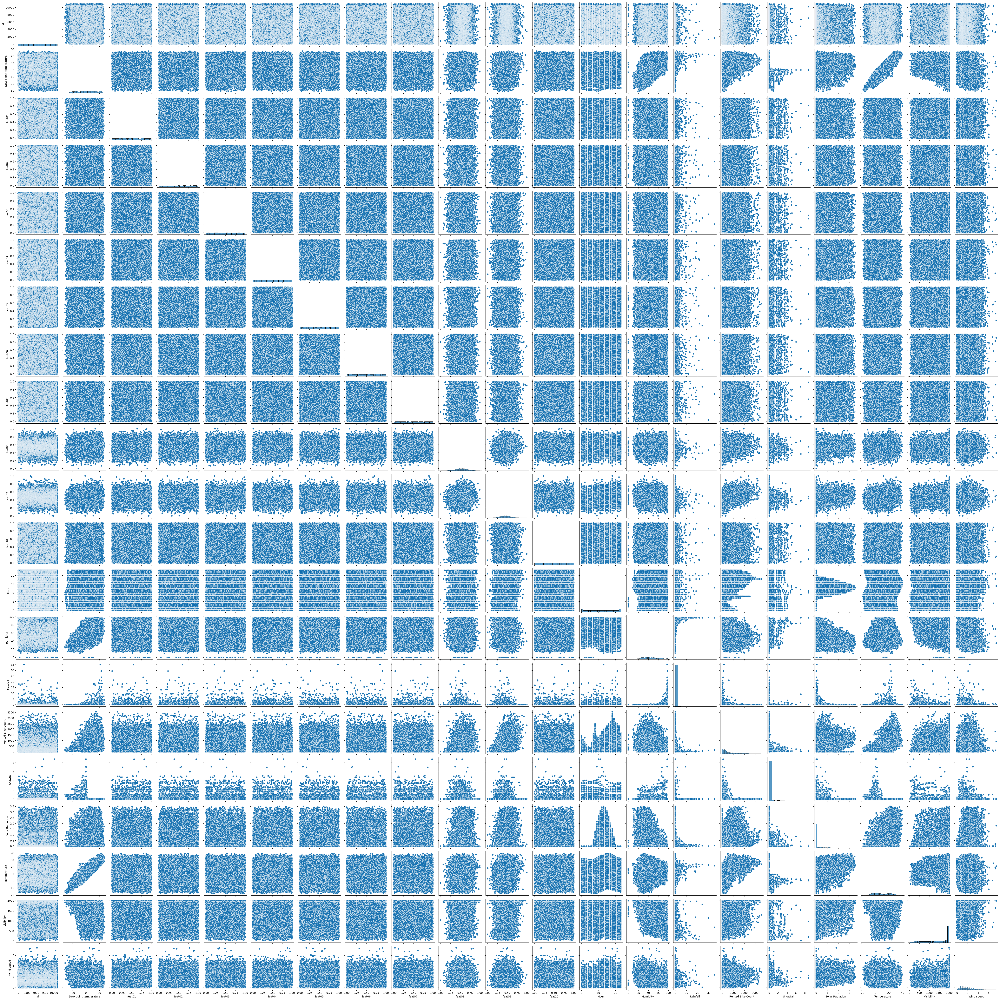

In [ ]:
g=sns.pairplot(data)

In [ ]:
data.columns

Index(['id', 'Date', 'Dew point temperature', 'feat01', 'feat02', 'feat03',
       'feat04', 'feat05', 'feat06', 'feat07', 'feat08', 'feat09', 'feat10',
       'Functioning Day', 'Holiday', 'Hour', 'Humidity', 'Rainfall',
       'Rented Bike Count', 'Seasons', 'Snowfall', 'Solar Radiation',
       'Temperature', 'Visibility', 'Wind speed'],
      dtype='object')

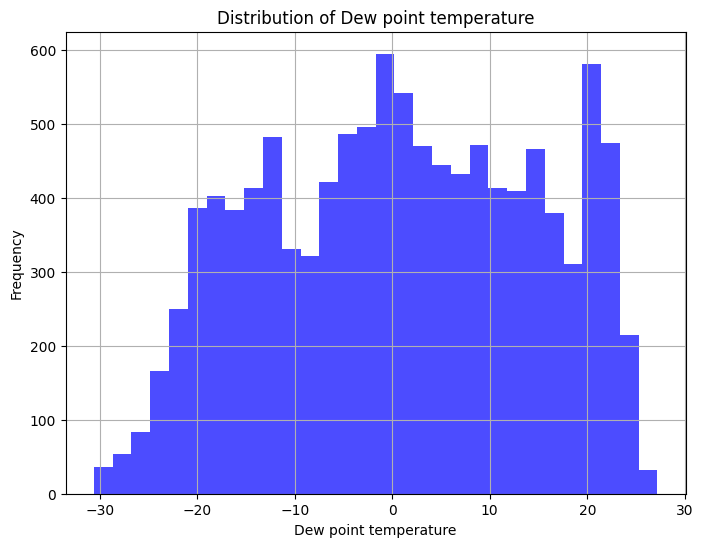

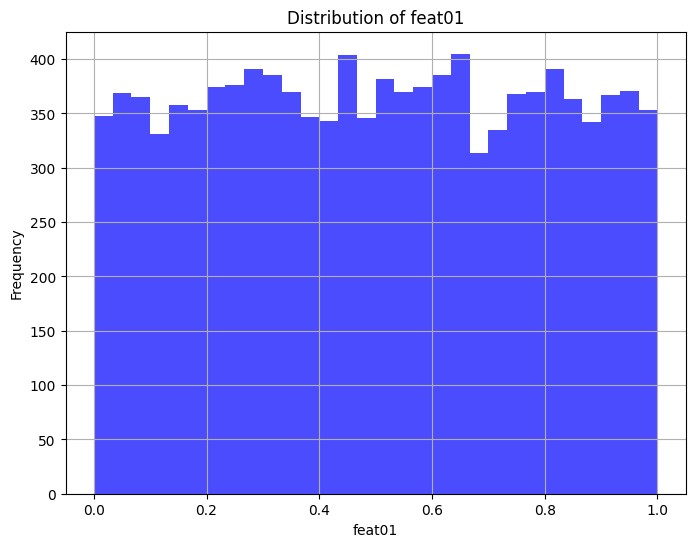

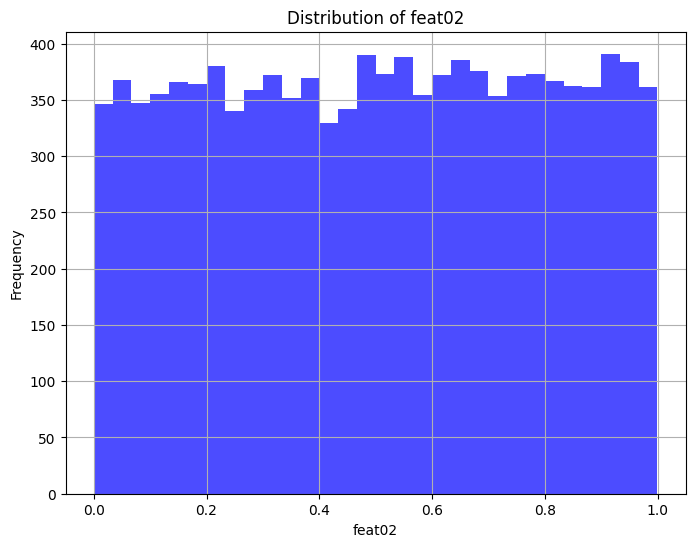

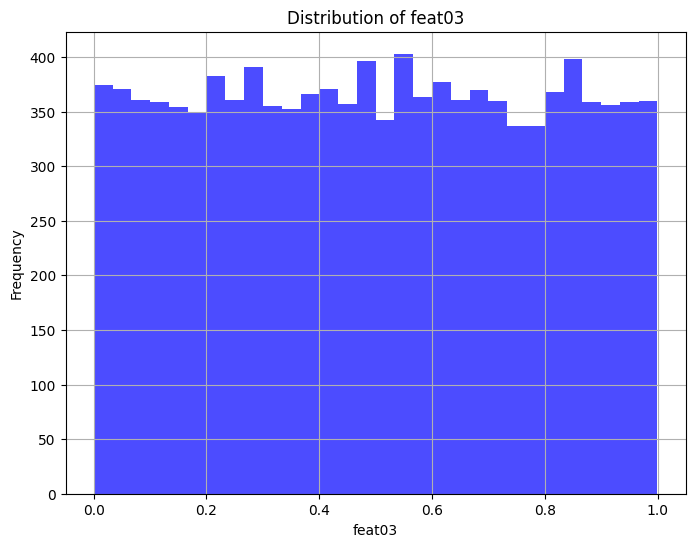

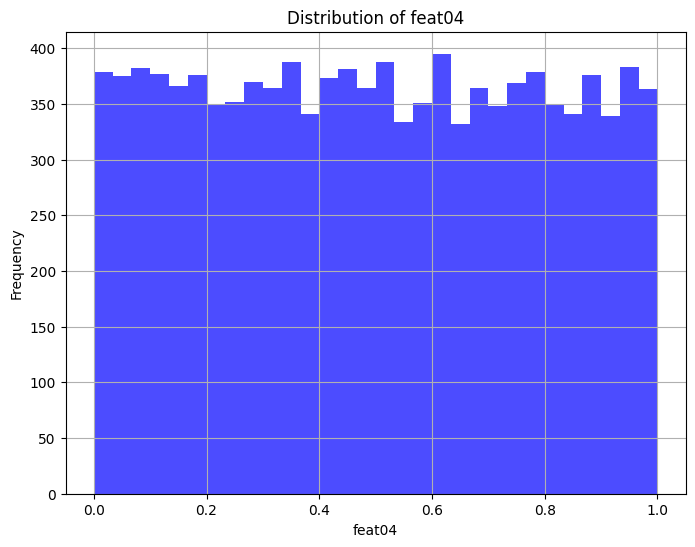

...

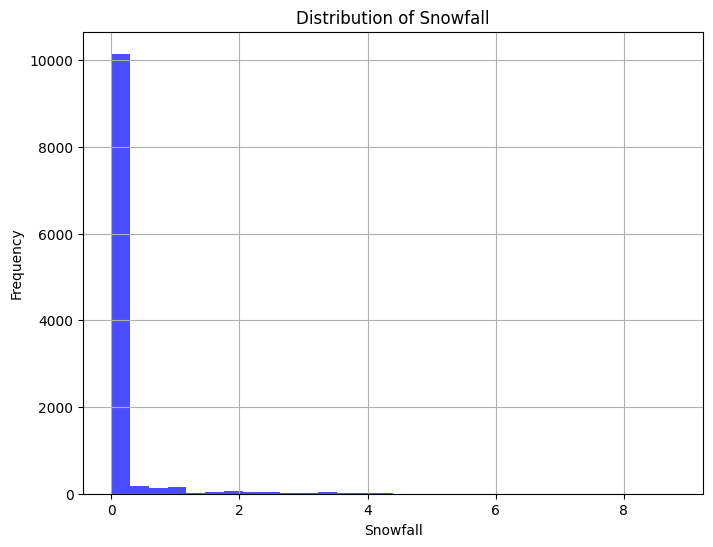

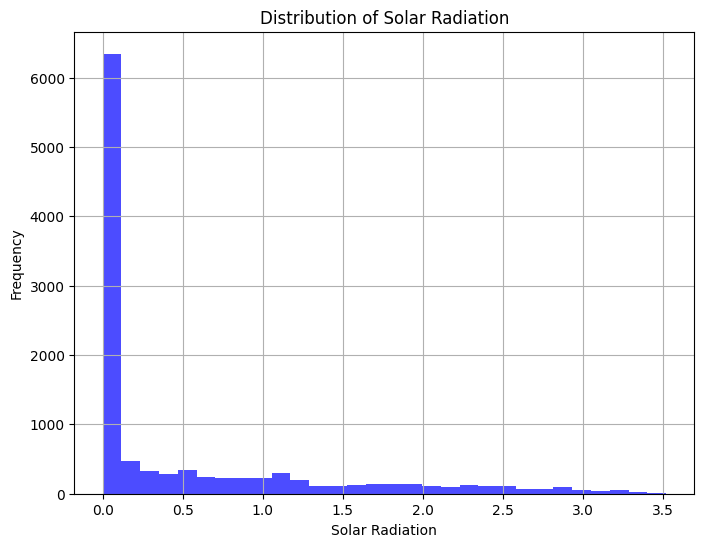

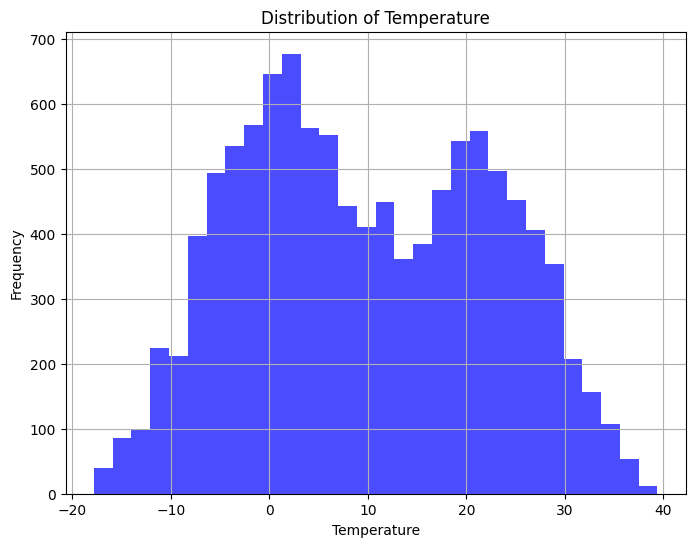

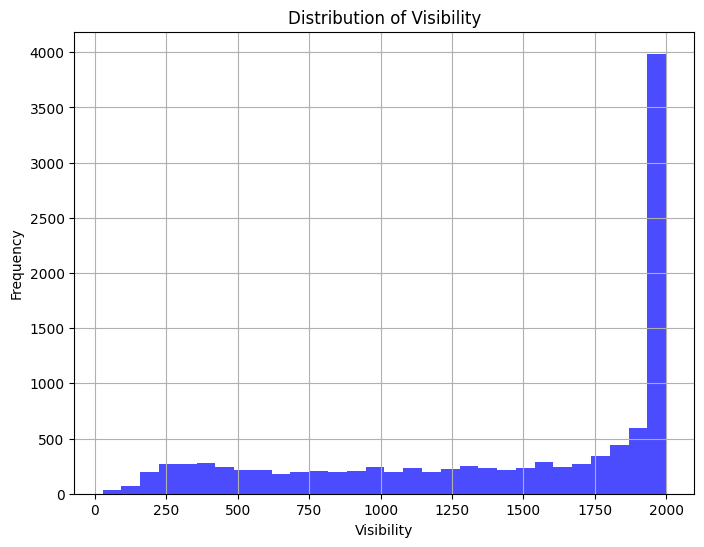

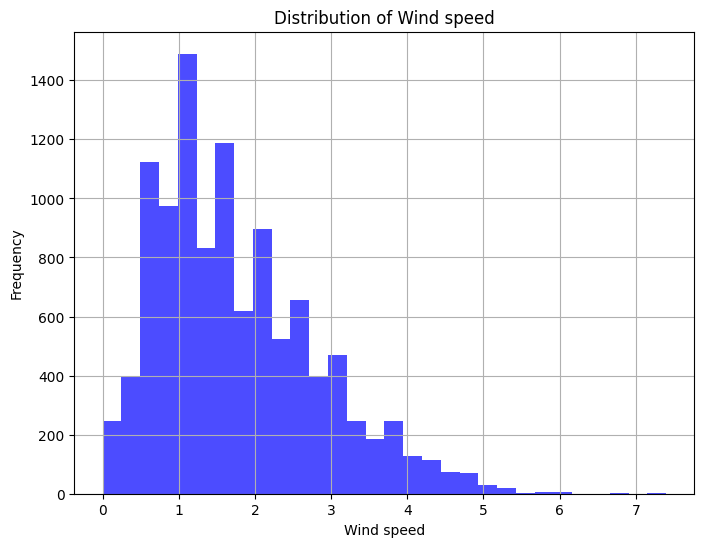

In [ ]:
for column in data.drop(['id','Date','hour_d'],axis=1).columns:
    plt.figure(figsize=(8, 6))
    data[column].hist(bins=30, color='blue', alpha=0.7)
    plt.title(f'Distribution of {column}')
    plt.xlabel(column)
    plt.ylabel('Frequency')
    plt.show()

<ipython-input-61-7d4698716fda>:8: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = data.corr(method='pearson')


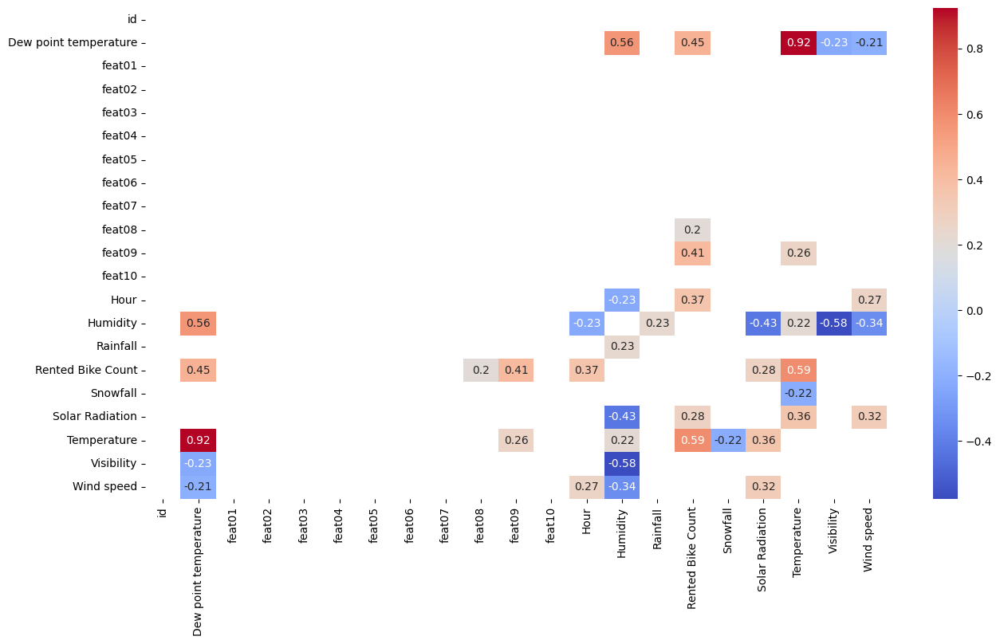

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set your threshold for correlation
correlation_threshold = 0.2

# Generate a correlation matrix
correlation_matrix = data.corr(method='pearson')

# Create a mask to hide values below the threshold
mask = (correlation_matrix.abs() >= correlation_threshold) & (correlation_matrix < 1)

# Set up the matplotlib figure
plt.figure(figsize=(15, 8))

# Create a heatmap with the masked values
sns.heatmap(correlation_matrix, annot=True, mask=~mask, cmap="coolwarm")

# Show the plot
plt.show()


In [ ]:
data['Date'] = pd.to_datetime(data['Date'], format='%d/%m/%Y')
data['hour_d'] = pd.to_timedelta(data['Hour'], unit='h')
data['Date']=data['Date'] + data['hour_d']

In [ ]:
data.iloc[0]

id                                         1
Date                     2018-06-28 14:00:00
Dew point temperature                   21.6
feat01                              0.807048
feat02                              0.661404
feat03                               0.23918
feat04                              0.029566
feat05                              0.285581
feat06                              0.919743
feat07                              0.658024
feat08                               0.75827
feat09                              0.567133
feat10                              0.885346
Functioning Day                          Yes
Holiday                           No Holiday
Hour                                      14
Humidity                                  72
Rainfall                                 0.0
Rented Bike Count                       1030
Seasons                               Summer
Snowfall                                 0.0
Solar Radiation                         0.91
Temperatur

In [ ]:
data.dtypes

id                                 int64
Date                      datetime64[ns]
Dew point temperature            float64
feat01                           float64
feat02                           float64
feat03                           float64
feat04                           float64
feat05                           float64
feat06                           float64
feat07                           float64
feat08                           float64
feat09                           float64
feat10                           float64
Functioning Day                   object
Holiday                           object
Hour                               int64
Humidity                           int64
Rainfall                         float64
Rented Bike Count                  int64
Seasons                           object
Snowfall                         float64
Solar Radiation                  float64
Temperature                      float64
Visibility                         int64
Wind speed      

In [ ]:
for i in data.dtypes:
  print(i)

int64
datetime64[ns]
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
float64
object
object
int64
int64
float64
int64
object
float64
float64
float64
int64
float64
timedelta64[ns]


# Label Encoding

In [ ]:
le = preprocessing.LabelEncoder()
data['Functioning Day']=le.fit_transform(data['Functioning Day'])
data['Holiday']=le.fit_transform(data['Holiday'])
data['Seasons']=le.fit_transform(data['Seasons'])

# Scaling

In [ ]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

In [ ]:
data.pop('id')
data.pop('Date')
data.pop('hour_d')

0       0 days 14:00:00
1       0 days 06:00:00
2       0 days 23:00:00
3       0 days 01:00:00
4       0 days 05:00:00
              ...      
10945   0 days 04:00:00
10946   0 days 06:00:00
10947   0 days 10:00:00
10948   0 days 10:00:00
10949   0 days 02:00:00
Name: hour_d, Length: 10950, dtype: timedelta64[ns]

In [ ]:
y=data.pop('Rented Bike Count')

In [ ]:
data[data.columns]=scaler.fit_transform(data)

In [ ]:
data

,Dew point temperature,feat01,feat02,feat03,feat04,feat05,feat06,feat07,feat08,feat09,...,Holiday,Hour,Humidity,Rainfall,Seasons,Snowfall,Solar Radiation,Temperature,Visibility,Wind speed
0,1.503813,1.068455,0.544071,-0.902324,-1.613114,-0.752685,1.452897,0.552846,1.644140,0.830312,...,0.250800,0.361796,0.755071,-0.122286,0.179470,-0.216253,0.480901,1.376062,-0.508494,1.153618
1,1.084720,0.971864,1.274086,1.220124,-1.680567,0.194999,-1.244869,0.334483,-1.338175,-0.152520,...,0.250800,-0.793671,1.341996,-0.122286,-0.680197,-0.216253,-0.616896,0.699834,-1.829119,-0.999892
2,-1.473193,-1.417703,-0.627005,0.607548,-1.432934,0.008614,0.233017,-0.683056,0.053105,-2.183689,...,0.250800,1.661696,-0.467691,-0.122286,1.039138,-0.216253,-0.629094,-1.615254,0.580614,0.966356
3,-0.663910,1.306287,1.652859,-0.427657,1.344482,1.261899,1.649737,1.585926,0.478377,-2.177278,...,0.250800,-1.515838,-0.125318,-0.122286,1.039138,-0.216253,-0.629094,-0.795824,0.503986,-1.187154
4,-1.003520,-1.150892,-1.479239,1.463097,0.135385,-0.232116,-0.746249,0.784494,-0.685316,-0.844246,...,0.250800,-0.938104,-0.027497,-0.122286,1.039138,-0.216253,-0.629094,-1.241340,0.820284,0.217309
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10945,0.065890,-0.496148,0.360726,1.672081,-1.714044,0.922582,1.649268,1.457612,-2.104848,-0.301976,...,0.250800,-1.082538,0.657250,-0.122286,-1.539865,-0.216253,-0.629094,-0.230975,-0.201978,-0.250845
10946,1.279815,-0.765138,0.505683,1.342033,-0.823410,1.602193,1.714768,0.581943,-0.954916,-2.931156,...,0.250800,-0.793671,2.026743,-0.122286,-0.680197,-0.216253,-0.629094,0.723701,-1.793250,-1.374416
10947,1.373750,-0.386576,1.442154,-1.232666,-0.629171,0.443336,-0.575285,1.087273,-1.315868,-0.635317,...,0.250800,-0.215938,0.950713,-0.122286,0.179470,-0.216253,1.298150,1.161260,-1.338368,0.310940
10948,-0.656684,-0.324292,-0.748935,1.309307,0.679980,0.844733,0.709715,-0.772116,-0.636902,0.239142,...,-3.987248,-0.215938,-0.174229,-0.122286,-0.680197,-0.216253,0.737054,-0.771958,-0.678056,3.307129


In [ ]:
X_train, X_test, y_train, y_test = train_test_split(data, y, test_size=0.2, random_state=42)

# Feature Selecction1

In [ ]:
from sklearn.tree import DecisionTreeClassifier
dt = DecisionTreeClassifier(random_state=15, criterion  = 'entropy', max_depth = 10)
dt.fit(X_train,y_train)

DecisionTreeClassifier(criterion='entropy', max_depth=10, random_state=15)

In [ ]:
dt.feature_importances_


array([0.09127157, 0.0178555 , 0.01907872, 0.01321541, 0.01372767,
       0.02322636, 0.01587002, 0.02907501, 0.05352264, 0.05546192,
       0.0168609 , 0.0083124 , 0.        , 0.14862967, 0.0835976 ,
       0.00398149, 0.01614959, 0.00351821, 0.07015127, 0.19986191,
       0.06946565, 0.04716651])

In [ ]:
import graphviz
from sklearn import tree

dot_data = tree.export_graphviz(dt, out_file=None,
    feature_names=data.columns,
    class_names=y.unique().astype(str),
    filled=True, rounded=True,
    special_characters=True)
graph = graphviz.Source(dot_data)
graph

In [ ]:
for i, column in enumerate(data):
    print('Importance of feature {}:, {:.3f}'.format(column, dt.feature_importances_[i]))

    fi = pd.DataFrame({'Variable': [column], 'Feature Importance Score': [dt.feature_importances_[i]]})

    try:
        final_fi = pd.concat([final_fi,fi], ignore_index = True)
    except:
        final_fi = fi


# Ordering the data
final_fi = final_fi.sort_values('Feature Importance Score', ascending = False).reset_index()
final_fi

Importance of feature Dew point temperature:, 0.091
Importance of feature feat01:, 0.018
Importance of feature feat02:, 0.019
Importance of feature feat03:, 0.013
Importance of feature feat04:, 0.014
Importance of feature feat05:, 0.023
Importance of feature feat06:, 0.016
Importance of feature feat07:, 0.029
Importance of feature feat08:, 0.054
Importance of feature feat09:, 0.055
Importance of feature feat10:, 0.017
Importance of feature Functioning Day:, 0.008
Importance of feature Holiday:, 0.000
Importance of feature Hour:, 0.149
Importance of feature Humidity:, 0.084
Importance of feature Rainfall:, 0.004
Importance of feature Seasons:, 0.016
Importance of feature Snowfall:, 0.004
Importance of feature Solar Radiation:, 0.070
Importance of feature Temperature:, 0.200
Importance of feature Visibility:, 0.069
Importance of feature Wind speed:, 0.047


,index,Variable,Feature Importance Score
0,19,Temperature,0.199862
1,13,Hour,0.148630
2,0,Dew point temperature,0.091272
3,14,Humidity,0.083598
4,18,Solar Radiation,0.070151
5,20,Visibility,0.069466
6,9,feat09,0.055462
7,8,feat08,0.053523
8,21,Wind speed,0.047167
9,7,feat07,0.029075


In [ ]:
final_fi['Variable'][0:10].values

array(['Temperature', 'Hour', 'Dew point temperature', 'Humidity',
       'Solar Radiation', 'Visibility', 'feat09', 'feat08', 'Wind speed',
       'feat07'], dtype=object)

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, explained_variance_score, mean_absolute_error, mean_squared_error
from math import sqrt

In [ ]:
# Split the data into X & y

test1 = final_fi['Variable'][0:10].values

X2 = data[test1].values
y2 = y

# Hold-out validation
X_train, X_test, y_train, y_test = train_test_split(X2, y2, train_size=0.80, test_size = 0.2, random_state=15)

lm2 = LinearRegression(fit_intercept = True)
lm2.fit(X_train, y_train)

y_pred = lm2.predict(X_train)


# Model Accuracy on testing dataset
print('The Accuracy  on the testing dataset is: ', lm2.score(X_test, y_test) )
print('The RMSE  on the testing dataset is: ',sqrt(mean_squared_error(y_test,lm2.predict(X_test))))
print('The MAE  on the testing dataset is: ',mean_absolute_error(y_test,lm2.predict(X_test)))

The Accuracy  on the testing dataset is:  0.5371339608475518
The RMSE  on the testing dataset is:  421.47861391294174
The MAE  on the testing dataset is:  309.6516833761564


# Feature Selection and Linear Regression

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_percentage_error
from sklearn.feature_selection import RFE

In [ ]:
model = LinearRegression()
recursive_linear = RFE(model,n_features_to_select=10, step=1)
recursive_linear = recursive_linear.fit(X_train, y_train)

In [ ]:
X_train_sele = recursive_linear.transform(X_train)
X_test_sele = recursive_linear.transform(X_test)

model.fit(X_train_sele, y_train)

LinearRegression()

In [ ]:
y_pred = model.predict(X_test_sele)

In [ ]:
from sklearn.metrics import r2_score
r2_score(y_test, y_pred)

0.5371339608475518

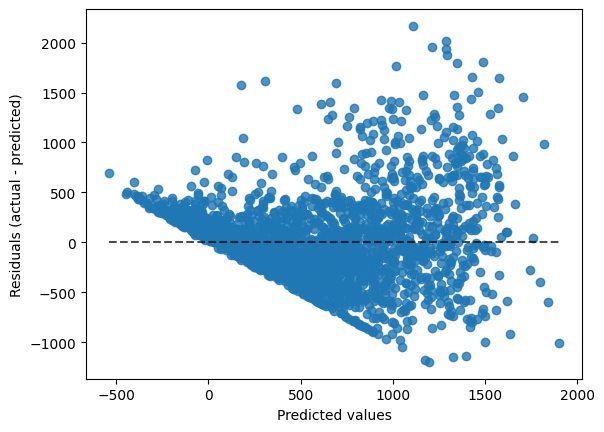

In [ ]:
from sklearn.metrics import PredictionErrorDisplay
display = PredictionErrorDisplay(y_true=y_test, y_pred=y_pred)
display.plot()
plt.show()

SVM

In [ ]:
X_train

array([[-6.68534359e-01, -5.04804394e-01,  8.58510680e-04, ...,
        -1.68284265e+00, -7.18999774e-01,  1.97025300e-01],
       [ 1.53517477e+00,  7.95095609e-01,  1.18588040e+00, ...,
        -8.81276492e-01,  9.66356356e-01, -1.04741991e+00],
       [ 3.65697361e-01,  1.22839561e+00,  4.41628848e-01, ...,
         2.07838062e-01,  4.98201875e-01, -1.11649018e+00],
       ...,
       [-2.46886042e-01,  5.06228942e-01, -9.52939596e-01, ...,
         6.70178441e-01,  8.72725459e-01,  1.32568578e-01],
       [ 8.98724479e-01, -1.22697106e+00,  1.12807446e+00, ...,
        -1.15834093e+00,  3.00473944e-02,  1.08401980e+00],
       [-8.51513817e-01, -1.22697106e+00, -5.33846489e-01, ...,
        -1.13128552e+00, -1.46804694e+00, -5.30455767e-03]])

In [ ]:
from sklearn.svm import SVR
estimator = SVR(kernel='linear')
selector = RFE(estimator, n_features_to_select=11, step=1)
selector = selector.fit(X_train, y_train)

In [ ]:
X_train_sele = selector.transform(X_train)
X_test_sele = selector.transform(X_test)

estimator.fit(X_train_sele, y_train)

SVR(kernel='linear')

In [ ]:
y_pred = estimator.predict(X_test_sele)

In [ ]:
from sklearn.metrics import r2_score
r2_score(y_test, y_pred)

0.4821088653233463

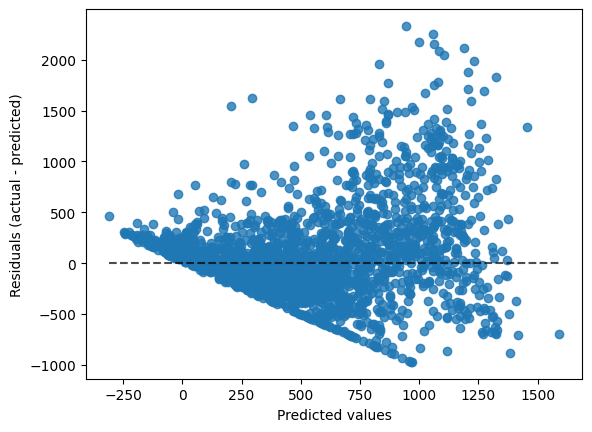

In [ ]:
from sklearn.metrics import PredictionErrorDisplay
display = PredictionErrorDisplay(y_true=y_test, y_pred=y_pred)
display.plot()
plt.show()

Random Forest

In [ ]:
X_train.shape

(8760, 10)

In [ ]:
from sklearn.ensemble import RandomForestRegressor

regr = RandomForestRegressor(max_depth=10, random_state=0)
regr.fit(X_train, y_train)

y_pred = regr.predict(X_train)


# Model Accuracy on testing dataset
print('The Accuracy  on the testing dataset is: ', regr.score(X_test, y_test) )
print('The RMSE  on the testing dataset is: ',sqrt(mean_squared_error(y_test,regr.predict(X_test))))
print('The MAE  on the testing dataset is: ',mean_absolute_error(y_test,regr.predict(X_test)))

The Accuracy  on the testing dataset is:  0.8232065786902251
The RMSE  on the testing dataset is:  260.48392941905826
The MAE  on the testing dataset is:  157.41928919838236


In [ ]:
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint

param_dist = {
    'bootstrap': [True],
    'max_depth': randint(10, 110),
    'max_features': randint(1, 4),
    'min_samples_leaf': randint(1, 6),
    'min_samples_split': randint(2, 13),
    'n_estimators': [100, 200, 300, 500, 1000]
}

random_search = RandomizedSearchCV(
    estimator=regr,
    param_distributions=param_dist,
    n_iter=100,  # Adjust the number of iterations based on computational resources
    cv=5,       # Increase the number of folds
    n_jobs=-1,
    verbose=2
)
random_search.fit(X_train, y_train)

random_search.best_params_

Fitting 5 folds for each of 100 candidates, totalling 500 fits


/usr/local/lib/python3.10/dist-packages/joblib/externals/loky/process_executor.py:752: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


{'bootstrap': True,
 'max_depth': 59,
 'max_features': 3,
 'min_samples_leaf': 2,
 'min_samples_split': 3,
 'n_estimators': 500}

In [ ]:
best_grid = random_search.best_params_

regr = RandomForestRegressor(**best_grid)
regr.fit(X_train, y_train)

y_pred = regr.predict(X_train)


# Model Accuracy on testing dataset
print('The Accuracy  on the testing dataset is: ', regr.score(X_test, y_test) )
print('The RMSE  on the testing dataset is: ',sqrt(mean_squared_error(y_test,regr.predict(X_test))))
print('The MAE  on the testing dataset is: ',mean_absolute_error(y_test,regr.predict(X_test)))

The Accuracy  on the testing dataset is:  0.8192744601558173
The RMSE  on the testing dataset is:  263.36475201645703
The MAE  on the testing dataset is:  160.2308939976347


XG Boost

In [ ]:
from sklearn.ensemble import GradientBoostingRegressor

reg = GradientBoostingRegressor(random_state=0)
reg.fit(X_train, y_train)

y_pred = reg.predict(X_train)

# Model Accuracy on testing dataset
print('The Accuracy  on the testing dataset is: ', reg.score(X_test, y_test) )
print('The RMSE  on the testing dataset is: ',sqrt(mean_squared_error(y_test,reg.predict(X_test))))
print('The MAE  on the testing dataset is: ',mean_absolute_error(y_test,reg.predict(X_test)))

The Accuracy  on the testing dataset is:  0.7882686626458503
The RMSE  on the testing dataset is:  285.06273969483004
The MAE  on the testing dataset is:  180.2980923541004


In [ ]:
from sklearn.model_selection import GridSearchCV
import xgboost as xgb

params = { 'max_depth': [3,6,9,12],
           'learning_rate': [0.01, 0.05, 0.1],
           'n_estimators': [100, 500, 1000],
           'colsample_bytree': [0.3, 0.7]}

xgbr = xgb.XGBRegressor(seed = 20)

clf = GridSearchCV(estimator=xgbr,
                   param_grid=params,
                   scoring='neg_mean_squared_error',
                   verbose=1)

clf.fit(X_train, y_train)

print("Best parameters:", clf.best_params_)

Fitting 5 folds for each of 72 candidates, totalling 360 fits
Best parameters: {'colsample_bytree': 0.7, 'learning_rate': 0.01, 'max_depth': 9, 'n_estimators': 1000}


In [ ]:
# Training the model on best parameters

xgbr = xgb.XGBRegressor(seed = 20, colsample_bytree = 0.7, learning_rate= 0.1, max_depth=12, n_estimators=500)
xgbr.fit(X_train, y_train)
xgbr

y_pred = xgbr.predict(X_train)
# Model Accuracy on testing dataset
print('The Accuracy  on the testing dataset is: ', xgbr.score(X_test, y_test) )
print('The RMSE  on the testing dataset is: ',sqrt(mean_squared_error(y_test,xgbr.predict(X_test))))
print('The MAE  on the testing dataset is: ',mean_absolute_error(y_test,xgbr.predict(X_test)))

The Accuracy  on the testing dataset is:  0.8323518223797378
The RMSE  on the testing dataset is:  253.65726349349183
The MAE  on the testing dataset is:  150.7411063586196


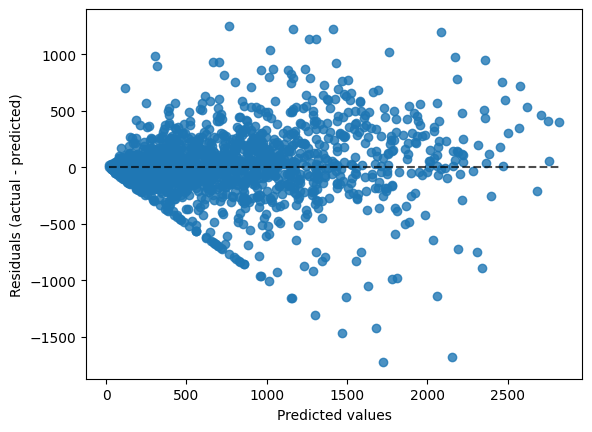

In [ ]:
from sklearn.metrics import PredictionErrorDisplay
display = PredictionErrorDisplay(y_true=y_test, y_pred=xgbr.predict(X_test))
display.plot()
plt.show()